# UMAPs Neurips samples, NK cells

In this notebook NK cells (or NK + ILC + gd T cells) are selected and UMAPs are generated using latent space coordinates. Clusters are identified using leiden algorithm. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap


import warnings

warnings.filterwarnings('ignore')

Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


# 1. Latent space

In [19]:
#Neurips
adata_neurips_latent = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad').copy()

In [22]:
prot=adata_neurips_latent.obsm['protein_expression_clr_neurips']

In [23]:
#some proteins and genes have same names, here _prot added after protein names
prot=prot.rename(columns={'CD2': 'CD2_prot', 'CX3CR1': 'CX3CR1_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})



In [26]:
#adding protein information to obs layer

a = adata_neurips_latent.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
adata_neurips_latent.obs=adata_eg



In [27]:
adata_neurips_latent

AnnData object with n_obs × n_vars = 80998 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16', 'CD25'

In [28]:
#Both NK cell types selected

neurips_nk_latent = adata_neurips_latent[(adata_neurips_latent.obs['cell_type'] == "NK") | (adata_neurips_latent.obs['cell_type'] == "NK CD158e1+")]

In [29]:
neurips_nk_latent

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16',

In [30]:
#selecting one sample from Neurips

eg_latent=adata_neurips_latent[adata_neurips_latent.obs['POOL'] == "s4d1"]

In [31]:
#selecting NK cells, gd T cells and ILCs from whole dataset

nk_all_latent = adata_neurips_latent[(adata_neurips_latent.obs['cell_type'] == "NK") | (adata_neurips_latent.obs['cell_type'] == "NK CD158e1+") | (adata_neurips_latent.obs['cell_type'] == "ILC") | (adata_neurips_latent.obs['cell_type'] == "gdT CD158b+")]   



## All samples, only NK cells

In [33]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(neurips_nk_latent, use_rep="X_totalVI")   

sc.tl.umap(neurips_nk_latent)

In [34]:
sc.tl.leiden(neurips_nk_latent, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(neurips_nk_latent, resolution = 0.6, key_added = "leiden_0.6")
sc.tl.leiden(neurips_nk_latent, resolution = 0.2, key_added = "leiden_0.2")
sc.tl.leiden(neurips_nk_latent, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(neurips_nk_latent, resolution = 1.4, key_added = "leiden_1.4")

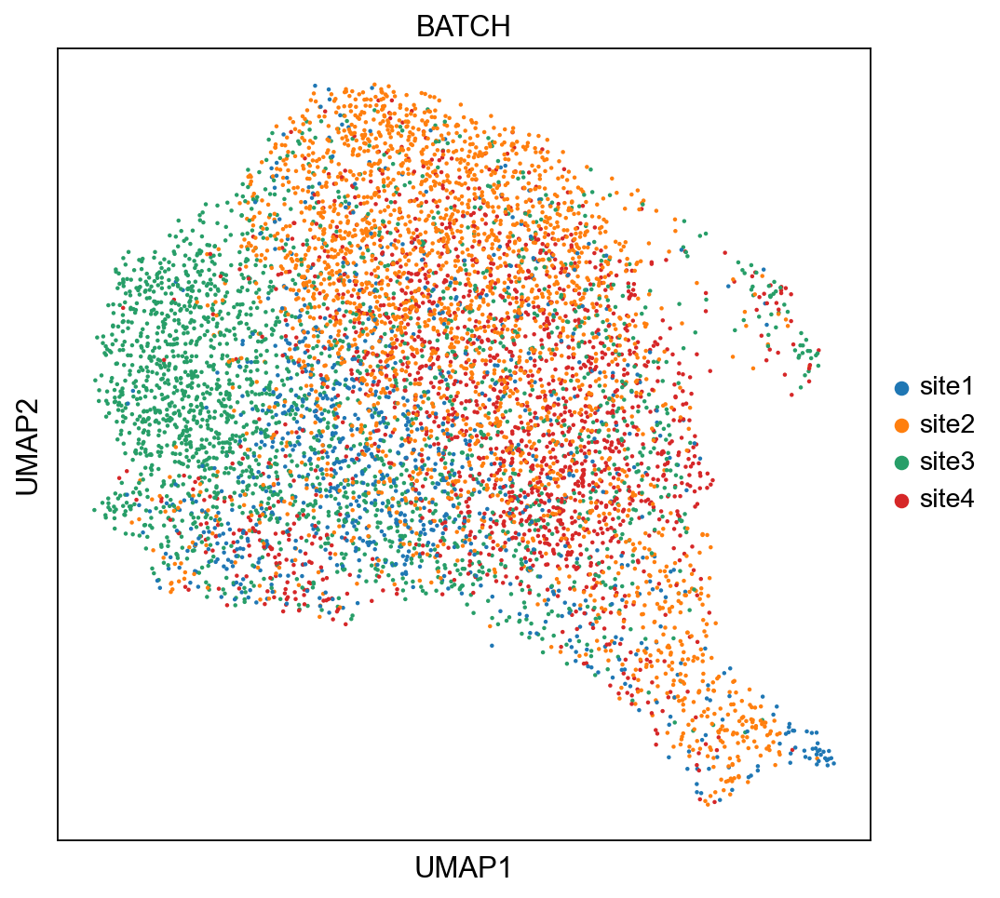

In [35]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(neurips_nk_latent, color = ['BATCH'], color_map = 'viridis')

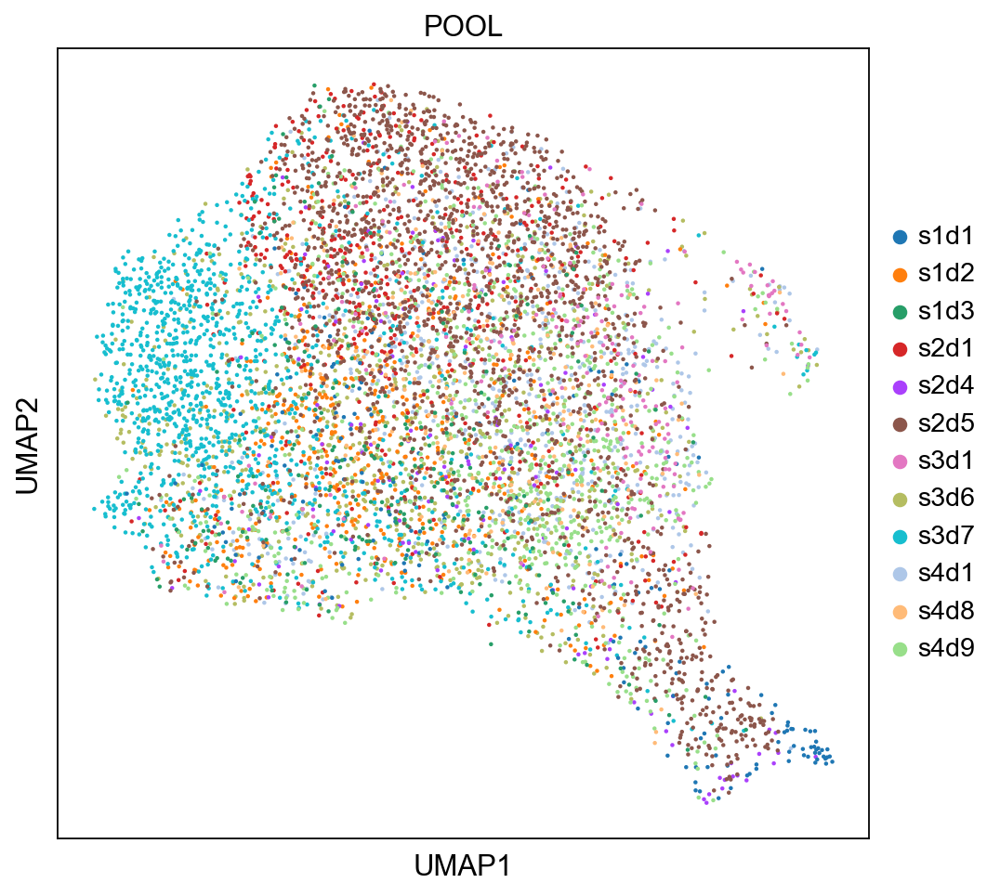

In [36]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(neurips_nk_latent, color = ['POOL'], color_map = 'viridis')

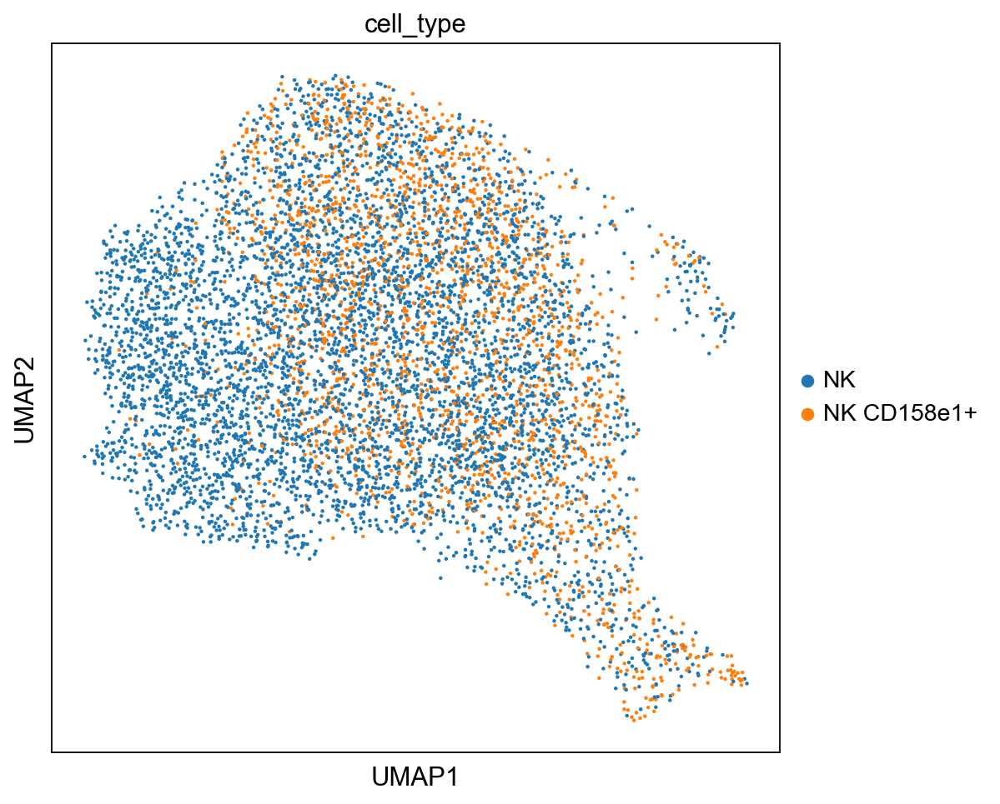

In [57]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(neurips_nk_latent, color = ['cell_type'], color_map = 'viridis')

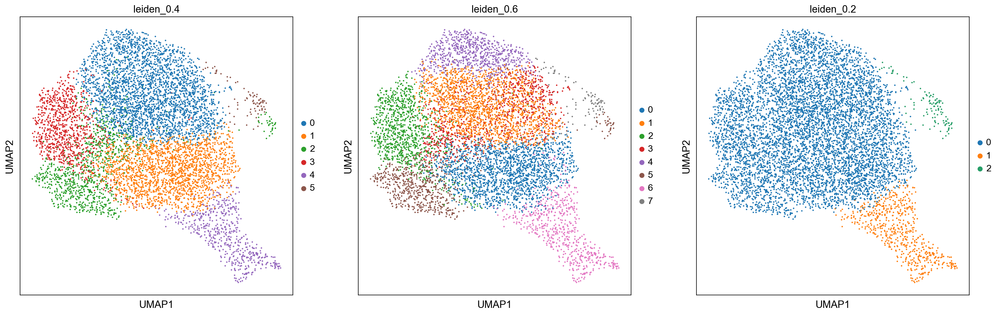

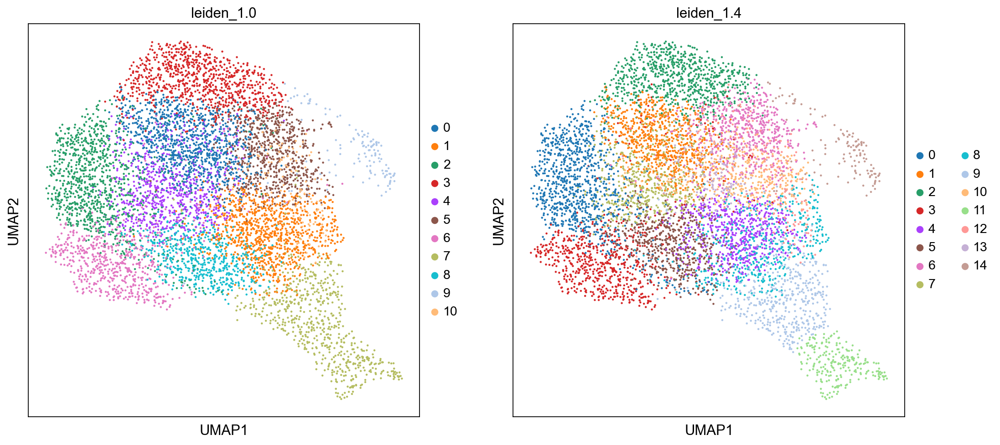

In [14]:
sc.pl.umap(neurips_nk_latent, color=['leiden_0.4', 'leiden_0.6', 'leiden_0.2'])


sc.pl.umap(neurips_nk_latent, color=['leiden_1.0','leiden_1.4'])




In [16]:
neurips_nk_latent

AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'leiden_1.0', 'leiden_0.6', 'leiden_0.4', 'leiden_1.4', 'leiden_0.2'
    uns: 'neighbors', 'umap', 'leiden', 'leiden_0.4_colors', 'leiden_0.6_colors', 'leiden_1.0_colors', 'leiden_1.4_colors', 'POOL_colors', 'BATCH_colors', 'leiden_0.2_colors'
  

In [45]:
#CD56(NCAM1), CD62L(SELL), CD94(KLRD1)

immature_nk_prot = ['CD56', 'CD62L', 'CD94']
immature_nk_rna = ['NCAM1', 'SELL', 'GZMK', 'XCL1']

#CD16 (FCGR3A), CD57 (B3GAT1, weak), CD38
mature_nk_prot = ['CD16', 'CD57', 'CD38_prot']
mature_nk_rna = ['CD38', 'GZMB', 'PRF1', 'FCGR3A', 'FGFBP2', 'SPON2', 'NKG7', 'KLF2', 'GZMH']



Immature markers, protein


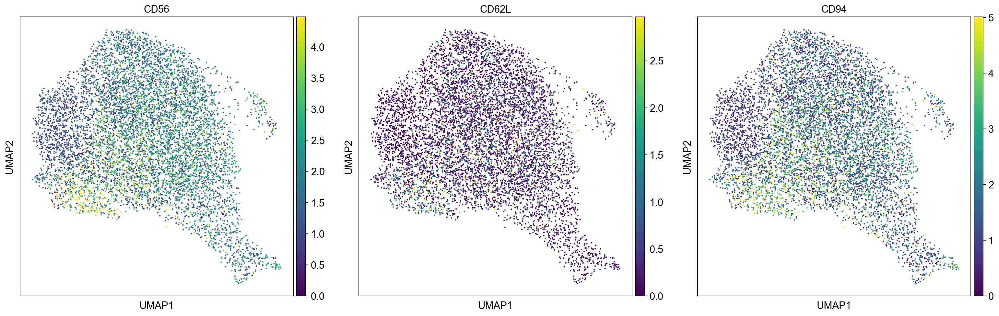

In [41]:
sc.set_figure_params(figsize=(7, 7))

print("Immature markers, protein")
sc.pl.umap(neurips_nk_latent, color = immature_nk_prot,vmax="p99", color_map = 'viridis')

Immature markers, RNA


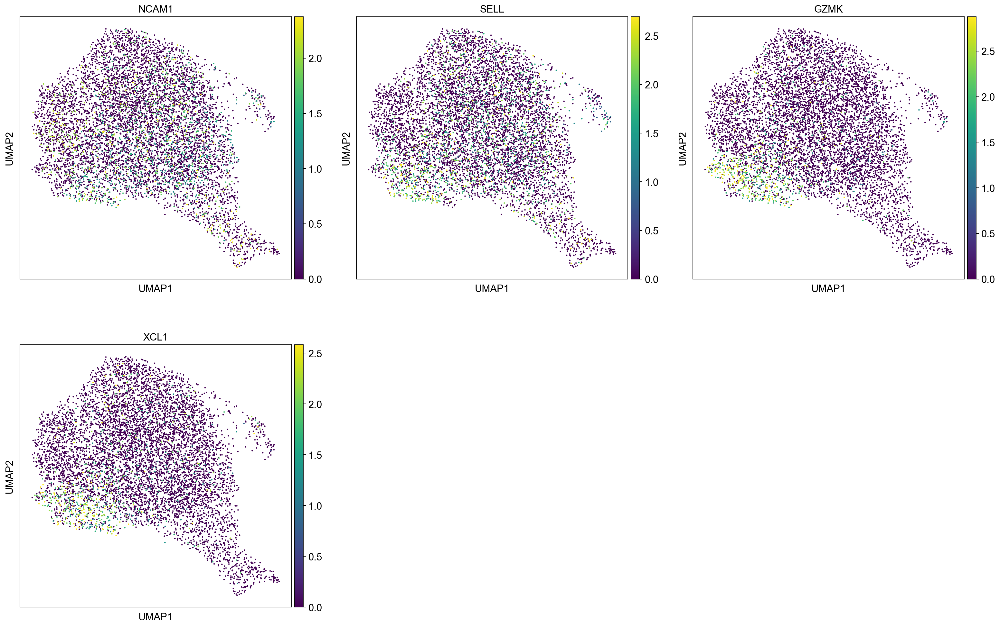

In [42]:
sc.set_figure_params(figsize=(7, 7))

print("Immature markers, RNA")
sc.pl.umap(neurips_nk_latent, color = immature_nk_rna,vmax="p99", color_map = 'viridis', ncols=3)

Mature markers, protein


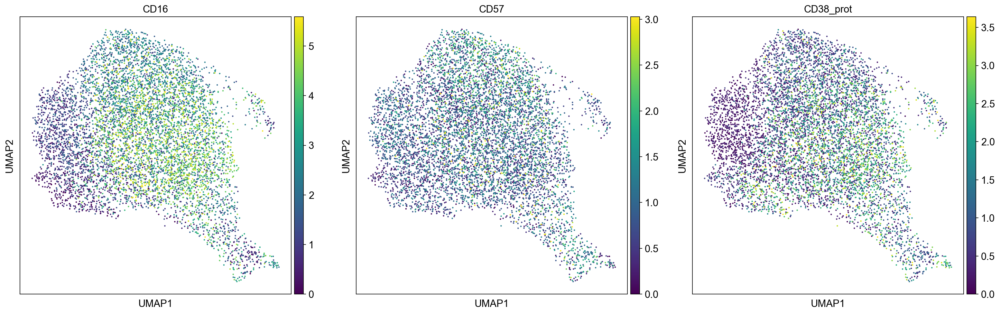

In [43]:
sc.set_figure_params(figsize=(7, 7))

print("Mature markers, protein")
sc.pl.umap(neurips_nk_latent, color = mature_nk_prot,vmax="p99", color_map = 'viridis')


Mature markers, RNA


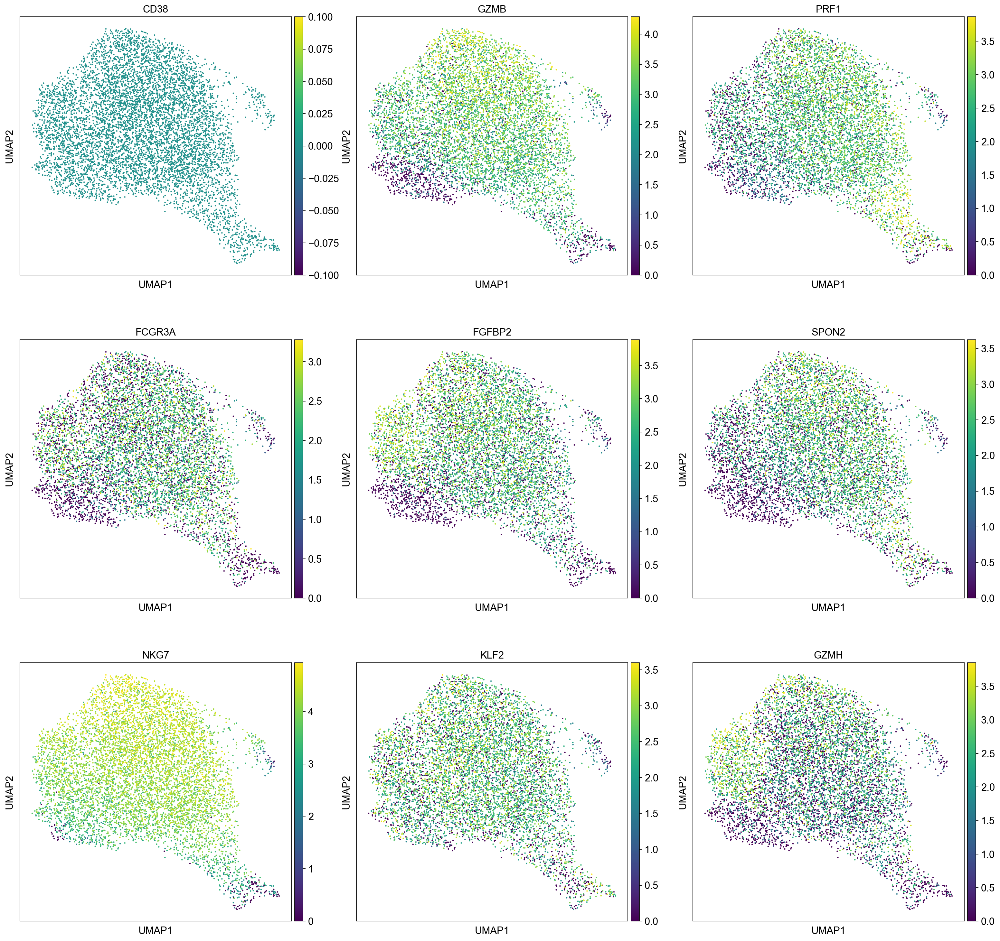

In [47]:
sc.set_figure_params(figsize=(7, 7))

print("Mature markers, RNA")
sc.pl.umap(neurips_nk_latent, color = mature_nk_rna,vmax="p99", color_map = 'viridis', ncols=3)



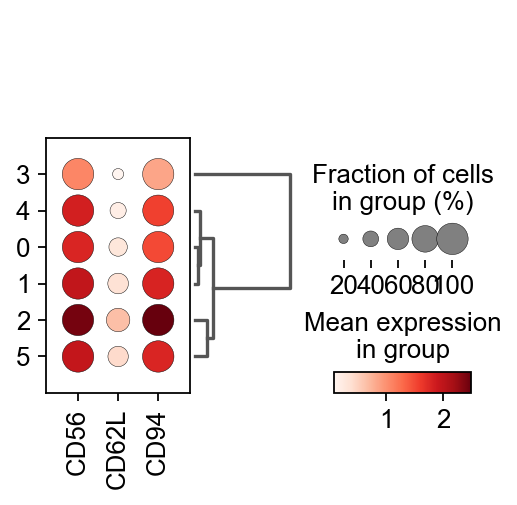

In [58]:
sc.pl.dotplot(neurips_nk_latent, immature_nk_prot, groupby='leiden_0.4', dendrogram=True)

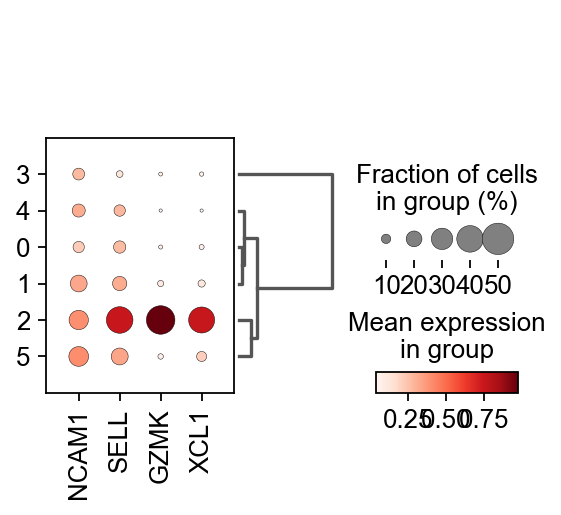

In [59]:
sc.pl.dotplot(neurips_nk_latent, immature_nk_rna, groupby='leiden_0.4', dendrogram=True)

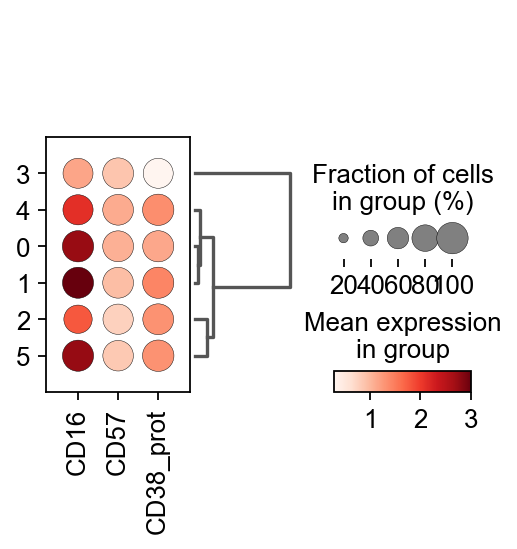

In [60]:
sc.pl.dotplot(neurips_nk_latent, mature_nk_prot, groupby='leiden_0.4', dendrogram=True)

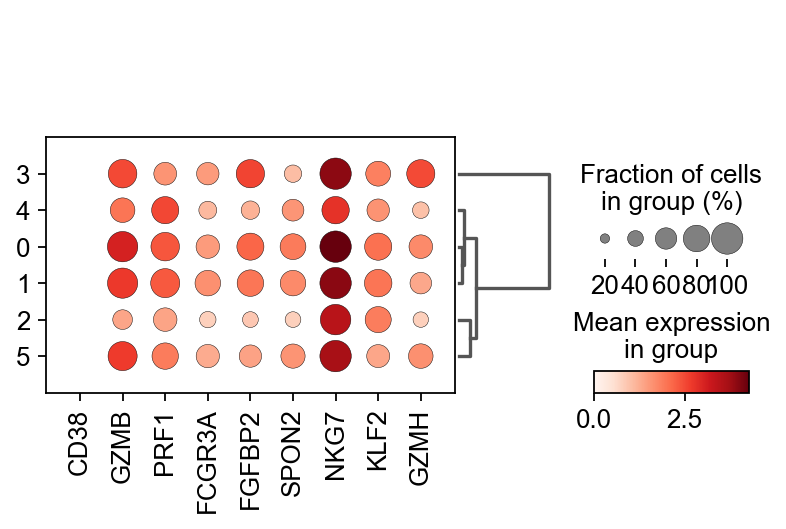

In [61]:
sc.pl.dotplot(neurips_nk_latent, mature_nk_rna, groupby='leiden_0.4', dendrogram=True)

# 4. All samples, NK + ILC + gdT

In [48]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(nk_all_latent, use_rep="X_totalVI")   

sc.tl.umap(nk_all_latent)

In [49]:
sc.tl.leiden(nk_all_latent, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(nk_all_latent, resolution = 0.6, key_added = "leiden_0.6")
sc.tl.leiden(nk_all_latent, resolution = 0.2, key_added = "leiden_0.2")
sc.tl.leiden(nk_all_latent, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(nk_all_latent, resolution = 1.4, key_added = "leiden_1.4")

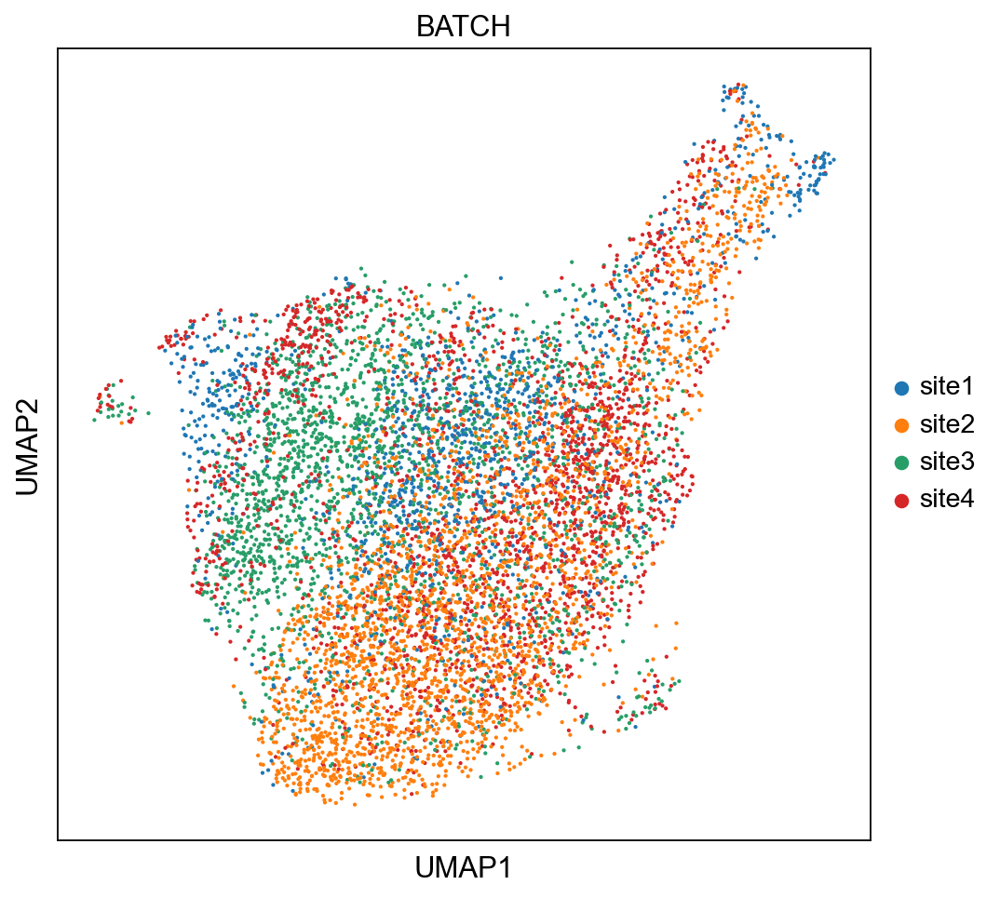

In [50]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(nk_all_latent, color = ['BATCH'], color_map = 'viridis')

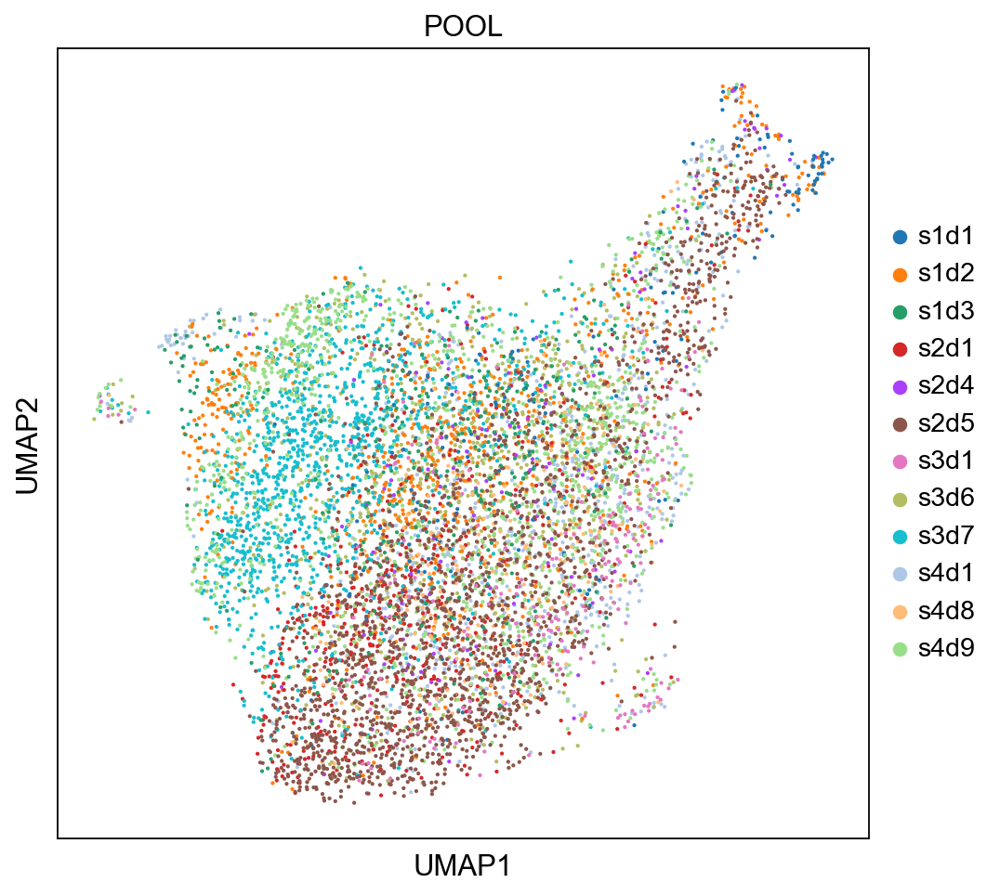

In [51]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(nk_all_latent, color = ['POOL'], color_map = 'viridis')

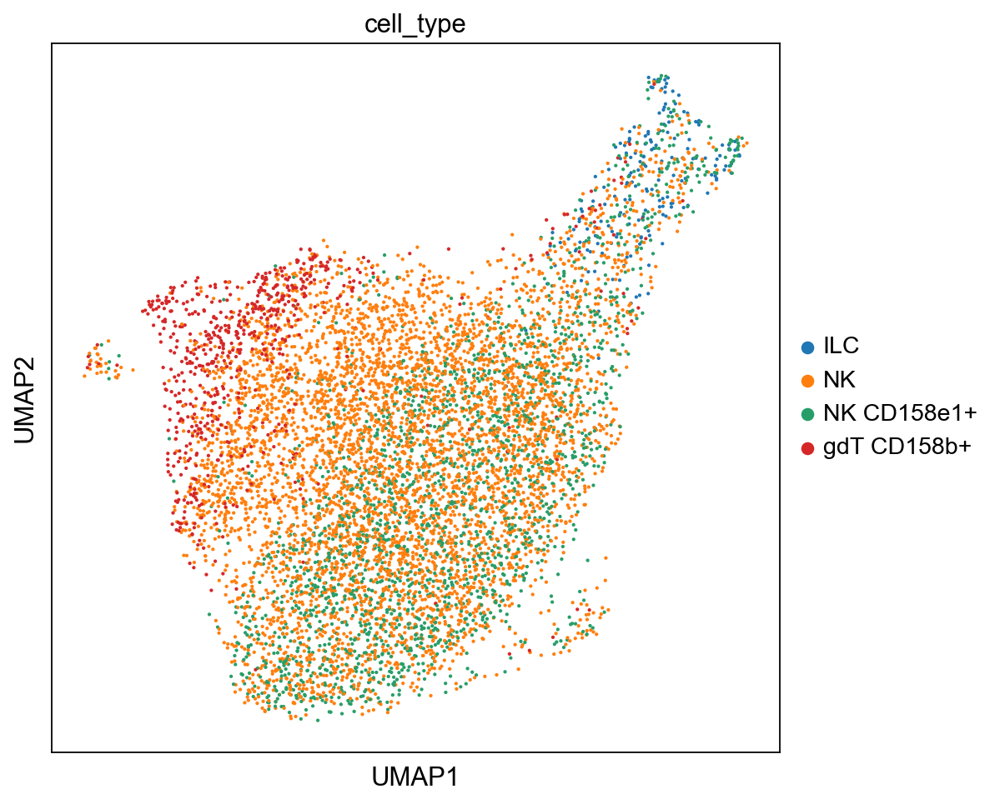

In [56]:
sc.set_figure_params(figsize=(7, 7))

sc.pl.umap(nk_all_latent, color = ['cell_type'], color_map = 'viridis')

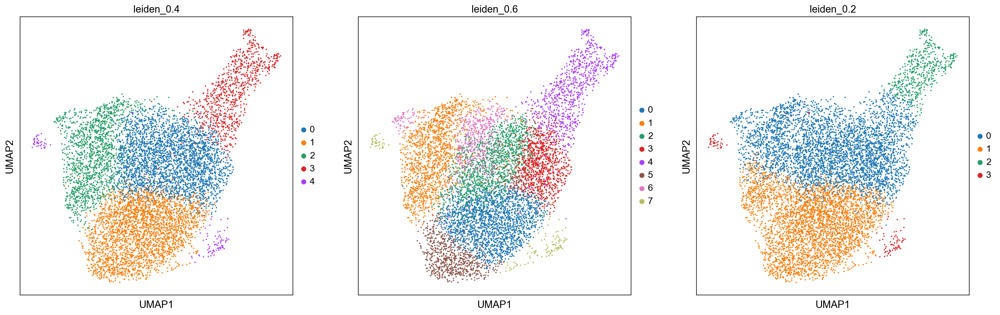

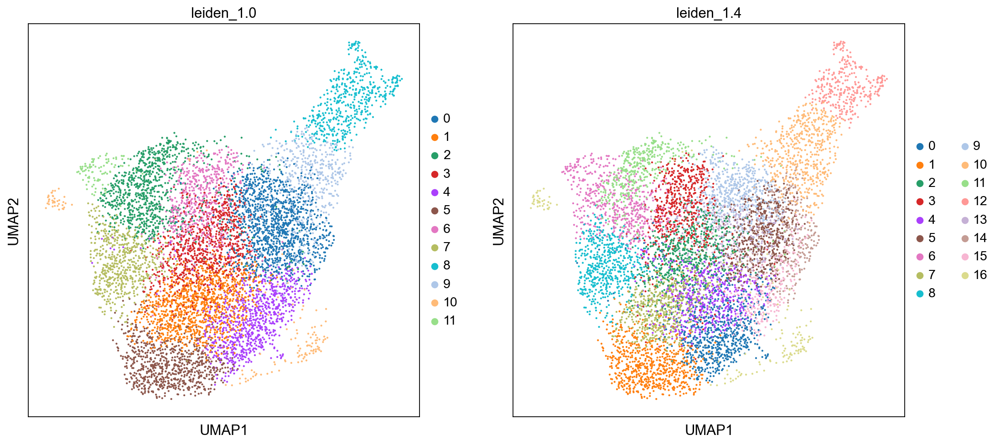

In [53]:
sc.pl.umap(nk_all_latent, color=['leiden_0.4', 'leiden_0.6', 'leiden_0.2'])


sc.pl.umap(nk_all_latent, color=['leiden_1.0','leiden_1.4'])

In [54]:
nk_all_latent

AnnData object with n_obs × n_vars = 8237 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS', 'CD86', 'CD274', 'CD270', 'CD155', 'CD112', 'CD47', 'CD48', 'CD40', 'CD154', 'CD52', 'CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'HLA-A-B-C', 'CD45RA', 'CD123', 'CD7_prot', 'CD105', 'CD49f', 'CD194', 'CD4', 'CD44_prot', 'CD14', 'CD16', 'CD25',

Immature markers, protein


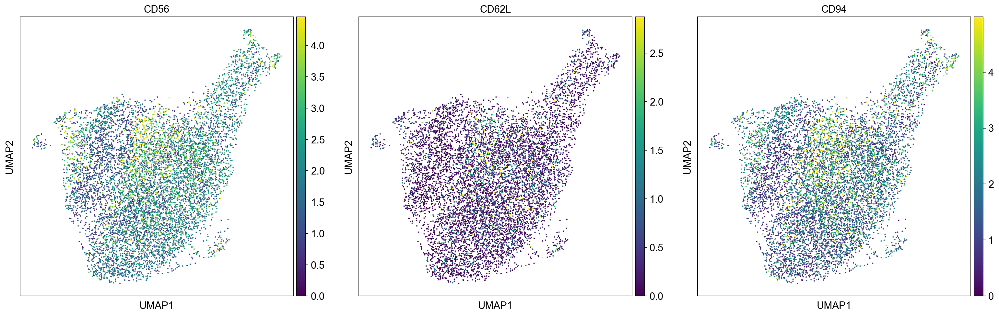

Immature markers, RNA


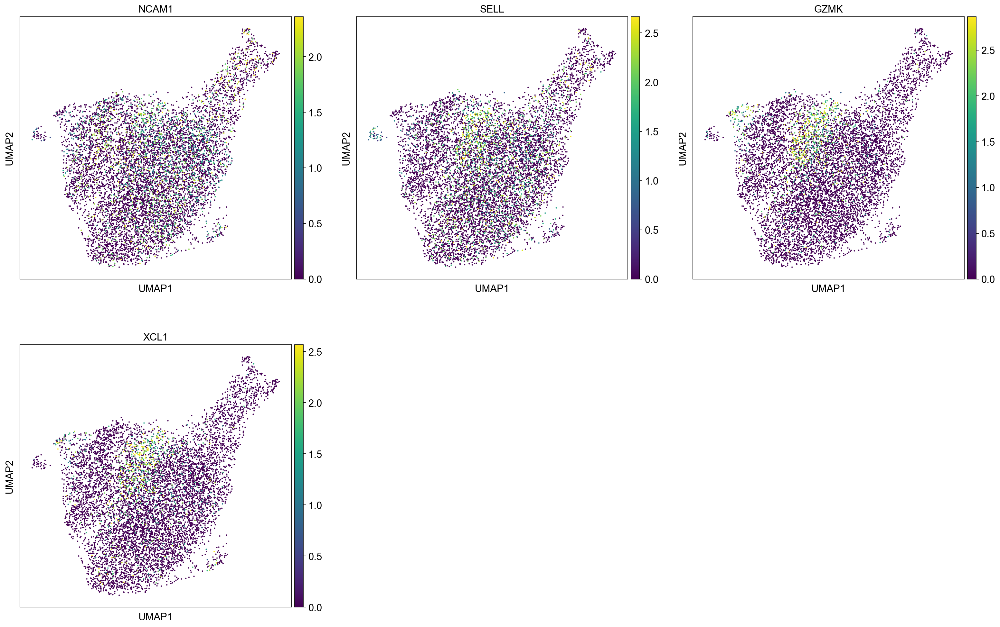

Mature markers, protein


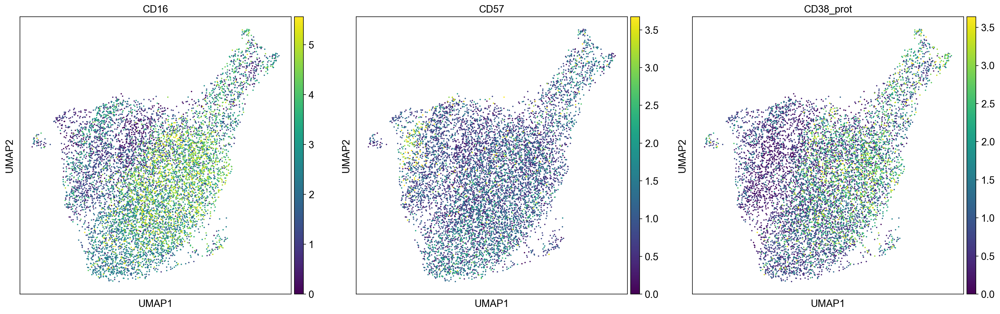

Mature markers, RNA


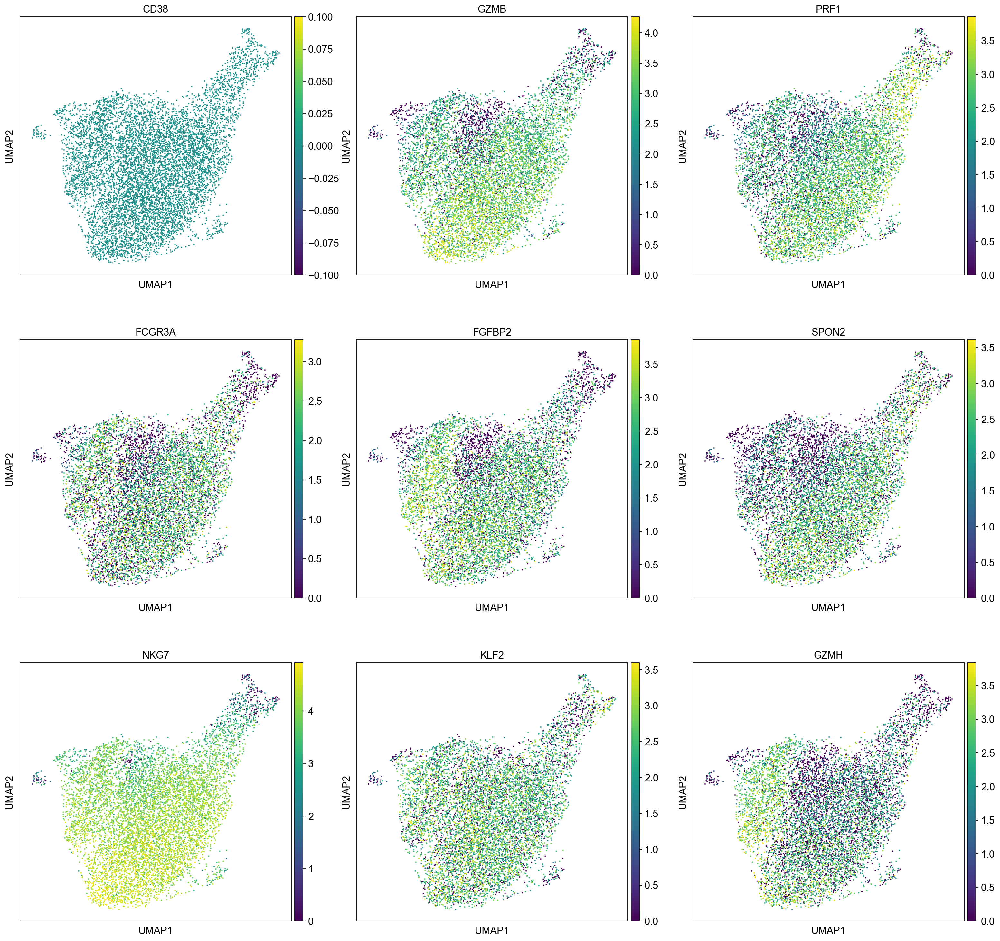

In [55]:
sc.set_figure_params(figsize=(7, 7))

print("Immature markers, protein")
sc.pl.umap(nk_all_latent, color = immature_nk_prot,vmax="p99", color_map = 'viridis')

sc.set_figure_params(figsize=(7, 7))

print("Immature markers, RNA")
sc.pl.umap(nk_all_latent, color = immature_nk_rna,vmax="p99", color_map = 'viridis', ncols=3)

sc.set_figure_params(figsize=(7, 7))

print("Mature markers, protein")
sc.pl.umap(nk_all_latent, color = mature_nk_prot,vmax="p99", color_map = 'viridis')


sc.set_figure_params(figsize=(7, 7))

print("Mature markers, RNA")
sc.pl.umap(nk_all_latent, color = mature_nk_rna,vmax="p99", color_map = 'viridis', ncols=3)